In [123]:
import numpy as np
from IPython.display import Audio, HTML

# Default sampling rate:
samplingrate = 48000

def db2amp(d):
    return 10 ** (float(d) / 20)
def amp2db(f):
    return 20 * np.log10(f)

def us2s(microseconds):
    return microseconds * 1e-6
def s2us(seconds):
    return seconds * 1e6

def ms2s(m_seconds):
    return m_seconds * 1e-3
def s2ms(seconds):
    return seconds * 1e3


def signal_energy(signal, fs=100e3):
    #signal = signal.astype(np.float64)
    #print np.min(signal), np.max(signal)
    return np.sum(signal.astype(np.float64) ** 2) / fs

def signal_power(signal, fs=100e3):
    return signal_energy(signal, fs=fs) / signal.size

def band_limits(center=8500, octave_width=1.0):
    return float(center) * 2**(-.5*octave_width), float(center) * 2**(+.5*octave_width)


def to_stereo(signal):
    """Return a tuple of left and right signal
    A single signal will be duplicated.
    A stereo signal will be returned unchanged.
    """
    try:
        signal_L, signal_R = signal
        #print "Play: Stereo"
    except ValueError:
        signal_L = signal
        signal_R = signal
        #print "Play: Mono"
    return (signal_L, signal_R)


def ramp(x = None, start = 0.0, stop = 1.0, ramp_dur = .005, fs = None, amp = 1.0):
    """ramp(x = np.ones(fs), start = .400, stop = .500, ramp_dur = .005, fs = fs, amp = 1.0)
    
    Ramp the signal x by linaer ramps between start and stop
    
    Examples
    ========
    
    >>> ramp()
    returns the default ramp function as it generates internally data x as all ones for 1 s with fs.
    """
    if fs is None:
        fs = samplingrate
    if x is None:
        x = np.ones(int(fs))
    t1 = start
    t2 = (start + ramp_dur)
    t3 = (stop - ramp_dur)
    t4 = stop
    t = np.arange(x.size) / fs
    r = amp * np.piecewise(t, [(t1 <= t) & (t < t2), (t2 <= t) & (t < t3), (t3 <= t) & (t < t4)],
                         [lambda t: (t - t1) / (t2-t1), 1, lambda t: 1 - (t - t3) / (t4-t3), 0])
    return r * x


def bandpass_itd_noise(min_freq = 20, max_freq = 20000, itd=0, fs=None, samples = None):
    """bandpass_itd_noise()
    """
    # Calculate available fft frequencies:
    if fs is None:
        fs = samplingrate
    if samples is None:
        samples = int(fs)
    freqs = np.fft.rfftfreq(samples, 1/fs)
    f = np.zeros_like(freqs)
    idx = np.where(np.logical_and(freqs>=min_freq, freqs<=max_freq))[0]
    f[idx] = 1 * np.sqrt(samples)
    f = np.array(f, dtype='complex')

    phases_rad = np.random.rand(len(f)) * 2 * np.pi
    phases = np.cos(phases_rad) + 1j * np.sin(phases_rad)

    itd_phas_rad = us2s(itd) * np.pi * freqs #  * .5 * 2
    shift_left = np.cos(-itd_phas_rad) + 1j * np.sin(-itd_phas_rad)
    shift_right = np.cos(+itd_phas_rad) + 1j * np.sin(+itd_phas_rad)
    phases_left = phases * shift_left
    phases_right = phases * shift_right

    f_left = f * phases_left
    f_right = f * phases_right

    s_left = np.fft.irfft(f_left).real
    s_right = np.fft.irfft(f_right).real
    return s_left, s_right


def do_ild(signal, ild = 0):
    signal_L, signal_R = to_stereo(signal)
    amp_L = db2amp(-.5 * ild)
    amp_R = db2amp(+.5 * ild)
    return amp_L * signal_L, amp_R * signal_R

def do_bc(signal, bc = 100, **noise_kwargs):
    signal_L, signal_R = to_stereo(signal)
    if bc != 100:
        if bc < 0:
            signal_R = -signal_R
        r = abs(bc / 100)
        _, decorr_noise_L = bandpass_itd_noise(itd=0, **noise_kwargs)
        _, decorr_noise_R = bandpass_itd_noise(itd=0, **noise_kwargs)
        # Adjust powers:
        decorr_noise_L = decorr_noise_L / (signal_power(decorr_noise_L) / signal_power(signal_L))**.5
        decorr_noise_R = decorr_noise_R / (signal_power(decorr_noise_R) / signal_power(signal_R))**.5
        signal_L = r**.5 * signal_L + (1 - r)**.5 * decorr_noise_L
        signal_R = r**.5 * signal_R + (1 - r)**.5 * decorr_noise_R
    return signal_L, signal_R

def noise(min_freq = 20, max_freq = 20000, itd=0, ild=0, bc=100, length=1.0, ramp_dur=0.005, return_signal=False):
    samples = int((length + 0.010) * samplingrate)
    signal_LR = bandpass_itd_noise(min_freq, max_freq, itd, samplingrate, samples)
    signal_LR = do_bc(signal_LR, bc=bc, min_freq=min_freq, max_freq=max_freq, fs=samplingrate, samples=samples)
    signal_LR = do_ild(signal_LR, ild)
    signal_LR = [ramp(s, start=0.005, stop=length+0.005, ramp_dur=ramp_dur) for s in signal_LR]
    display(HTML(f'<p><strong>Noise</strong> {min_freq}-{max_freq} Hz, '
                 f'ITD = {itd} μs, ILD = {ild} dB, BC = {bc}%'
                 '</p><style type="text/css">audio {min-width: 400px; }</style>'))
    display(Audio(np.vstack(signal_LR), rate=samplingrate, autoplay=False))
    if return_signal:
        return signal_LR

def tone(freq = 440, itd=0, ild=0, bc=100, length=1.0, ramp_dur=0.005, return_signal=False, **bc_noise_kwargs):
    samples = int((length + 0.010) * samplingrate)
    t = np.arange(0, samples) / samplingrate
    phase = np.random.rand(1) * 2 * np.pi
    shift = us2s(itd) * np.pi * freq
    signal_LR = (
        np.sin(t * 2 * np.pi * freq + phase - shift),
        np.sin(t * 2 * np.pi * freq + phase + shift)
    )
    signal_LR = do_bc(signal_LR, bc=bc, fs=samplingrate, samples=samples, **bc_noise_kwargs)
    signal_LR = do_ild(signal_LR, ild)
    signal_LR = [ramp(s, start=0.005, stop=length+0.005, ramp_dur=ramp_dur) for s in signal_LR]
    display(HTML(f'<p><strong>Tone</strong> {freq} Hz, '
                 f'ITD = {itd} μs, ILD = {ild} dB, BC = {bc}%'
                 '</p><style type="text/css">audio {min-width: 400px; }</style>'))
    display(Audio(np.vstack(signal_LR), rate=samplingrate, autoplay=False))
    if return_signal:
        return signal_LR


In [131]:
tone(4400, itd=-200, bc=100)
tone(4400, itd=0,    bc=100)
tone(4400, itd=200,  bc=100)
print()
tone(1500, itd=-200, bc=100)
tone(1500, itd=0,    bc=100)
tone(1500, itd=200,  bc=100)
print()
tone(1500, itd=0, ild=-5, bc=100)
tone(1500, itd=0, ild=0, bc=100)
tone(1500, itd=0, ild=+5, bc=100)
print()
tone(440, itd=-200, bc=100)
tone(440, itd=0,    bc=100)
tone(440, itd=200,  bc=100)
print()
tone(440, itd=-300, bc=90)
tone(440, itd=0,    bc=90)
tone(440, itd=300,  bc=90)

In [149]:
noise(min_freq=1400, max_freq=2400, length=5, bc=80, itd=-600)
noise(min_freq=1400, max_freq=2400, length=5, bc=80, itd=0)
noise(min_freq=1400, max_freq=2400, length=5, bc=80, itd=600)


In [ ]:
%matplotlib notebook
import matplotlib.pyplot as plt

<IPython.core.display.Javascript object>


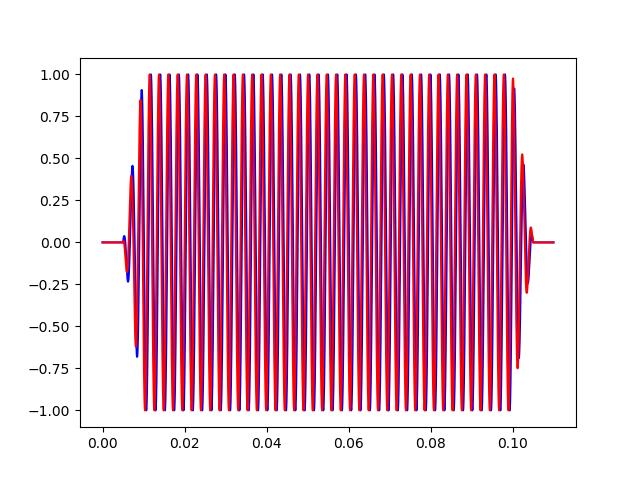

In [60]:
plt.figure()
signal_LR = tone(440, itd=300,  bc=100, length=.1, return_signal=True)
plt.plot(np.arange(len(signal_LR[0]))/samplingrate, signal_LR[0], '-b')
plt.plot(np.arange(len(signal_LR[0]))/samplingrate, signal_LR[1], '-r')

<IPython.core.display.Javascript object>


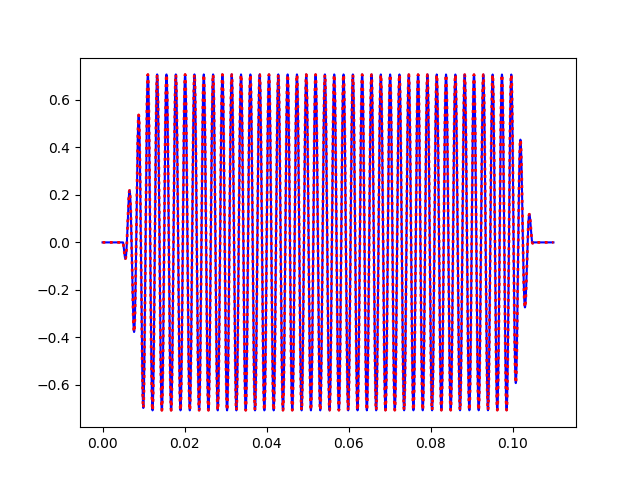

In [65]:
plt.figure()
signal_LR = tone(440, itd=0,  bc=50, length=.1, return_signal=True)
plt.plot(np.arange(len(signal_LR[0]))/samplingrate, signal_LR[0], '-b')
plt.plot(np.arange(len(signal_LR[0]))/samplingrate, signal_LR[1], ':r', lw=2)

In [121]:
noise()
noise(min_freq=5000)

4.8364031164756605e-06
4.83562239072288e-06


<IPython.core.display.Javascript object>


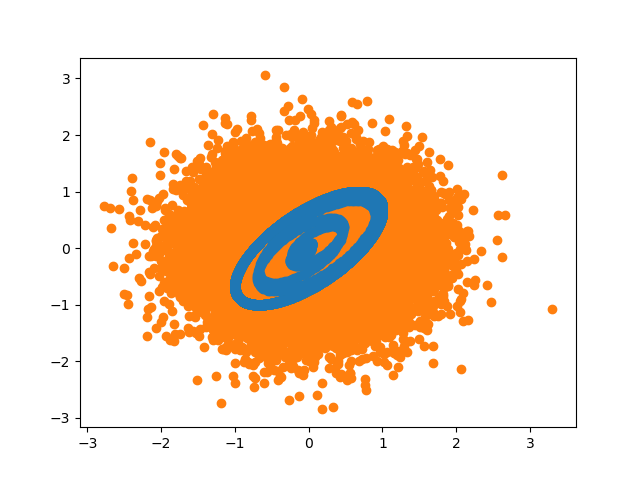

In [106]:
tone(itd=0, bc=100, length=.5, return_signal=True)
sig_bc100 = tone(itd=300, bc=100, length=.5, return_signal=True)
tone(itd=0, bc= 10, length=.5, min_freq=200, max_freq=12000, return_signal=True)
tone(itd=150, bc= 10, length=.5, min_freq=200, max_freq=12000, return_signal=True)
sig_bc050 = tone(itd=300, bc= 1, length=.5, min_freq=200, max_freq=12000, return_signal=True)
print(signal_power(sig_bc100[0]))
print(signal_power(sig_bc050[0]))
plt.figure()
plt.scatter(sig_bc100[0], sig_bc100[1], zorder=5)
plt.scatter(sig_bc050[0], sig_bc050[1])

In [35]:
bcs = [100, 95, 90, 80, 60, 40, 20, 0]

print("ITD = -300 (left)")
for bc in bcs:
  print(f"BC = {bc} %")
  noise(length=1, itd=-300, bc=bc)

print("ITD = 0 (center)")
for bc in bcs:
  print(f"BC = {bc} %")
  noise(length=1, itd=0, bc=bc)

print("ITD = +300 (right)")
for bc in bcs:
  print(f"BC = {bc} %")
  noise(length=1, itd=300, bc=bc)
  

ITD = -300 (left)
BC = 100 %


BC = 95 %


BC = 90 %


BC = 80 %


BC = 60 %


BC = 40 %


BC = 20 %


BC = 0 %


ITD = 0 (center)
BC = 100 %


BC = 95 %


BC = 90 %


BC = 80 %


BC = 60 %


BC = 40 %


BC = 20 %


BC = 0 %


ITD = +300 (right)
BC = 100 %


BC = 95 %


BC = 90 %


BC = 80 %


BC = 60 %


BC = 40 %


BC = 20 %


BC = 0 %


In [9]:
#for itd in [-1800, -1200, -600, -300, -150, 0, 150, 300, 600, 1200, 1800]:
for itd in [-600, 0, 600]:
    print(f"ITD: {itd}")
    tone(f = 440, itd=itd, ramp_dur=0.010, bc=100)
    tone(f = 440, itd=itd, ramp_dur=0.010, bc=50)
    tone(f = 440, itd=itd, ramp_dur=0.010, bc=50)
    tone(f = 440, itd=itd, ramp_dur=0.010, bc=50)
    tone(f = 440, itd=itd, ramp_dur=0.010, bc=0)

ITD: -600


ITD: 0


ITD: 600


In [4]:
print("ITD = -300 (left)")
noise(length=1, itd=-300)

print("ITD = 0 (center)")
noise(length=1, itd=0)

print("ITD = +300 (right)")
noise(length=1, itd=300)

ITD = -300 (left)


ITD = 0 (center)


ITD = +300 (right)


In [5]:
for low, high in [(20, 12000), (20, 5000), (5000, 12000)]:

  print(f"Bandwidth: {low} to {high} Hz")
  
  for itd in [-300, 0, 300]:
    print(f"ITD: {itd}")

    noise(min_freq=low, max_freq=high, itd=itd)

Bandwidth: 20 to 12000 Hz
ITD: -300


ITD: 0


ITD: 300


Bandwidth: 20 to 5000 Hz
ITD: -300


ITD: 0


ITD: 300


Bandwidth: 5000 to 12000 Hz
ITD: -300


ITD: 0


ITD: 300


In [6]:
for low, high in [(20, 12000), (20, 5000), (5000, 12000)]:

  print(f"Bandwidth: {low} to {high} Hz")
  
  for ild in [-10, 0, 10]:
    print(f"ILD: {ild}")

    noise(min_freq=low, max_freq=high, itd=0, ild=ild)

Bandwidth: 20 to 12000 Hz
ILD: -10


ILD: 0


ILD: 10


Bandwidth: 20 to 5000 Hz
ILD: -10


ILD: 0


ILD: 10


Bandwidth: 5000 to 12000 Hz
ILD: -10


ILD: 0


ILD: 10


In [14]:
sL1, sR1 = bandpass_itd_noise(min_freq =   20, max_freq=20000, itd =   0)
sL2, sR2 = bandpass_itd_noise(min_freq =   20, max_freq=20000, itd = 300)
sL2b, sR2b = bandpass_itd_noise(min_freq =   20, max_freq=20000, itd = -300)
sL3, sR3 = bandpass_itd_noise(min_freq = 4000, max_freq=20000, itd =   0)
sL4, sR4 = bandpass_itd_noise(min_freq = 4000, max_freq=20000, itd = 150)

print("Broad, center")
display(Audio([sL1, sR1], rate=samplingrate))

print("Broad, right (ITD = 150)")
display(Audio([sL2, sR2], rate=samplingrate))

print("Broad, center-right-left-center")
display(Audio([ramp(np.concatenate([sL1, sL2, sL2b, sL1]), stop=4), ramp(np.concatenate([sR1, sR2, sR2b, sR1]), stop=4)], rate=samplingrate))

print("High, center")
display(Audio(np.vstack([sL3, sR3]), rate=samplingrate))

print("High, right (ITD = 150)")
display(Audio(np.vstack([sL4, sR4]), rate=samplingrate))

print("High, center-right-center")
display(Audio(np.vstack([ramp(np.hstack([sL3, sL4, sL3]), stop=3), ramp(np.hstack([sR3, sR4, sR3]), stop=3)]), rate=samplingrate))



Broad, center


Broad, right (ITD = 150)


Broad, center-right-left-center


High, center


High, right (ITD = 150)


High, center-right-center
